In [108]:
#import all import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import timeit
from time import time
import sys
import os
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.express as px
import plotly.graph_objects as go

In [2]:
init_notebook_mode(connected=True)

In [3]:
#check system version
sys.version

'3.8.12 (default, Oct 12 2021, 06:23:56) \n[Clang 10.0.0 ]'

In [4]:
os.listdir()

['Pre-interview_Exercise.pptx',
 '.DS_Store',
 'hotel_bookings2.csv',
 'hotel_bookings.csv',
 'Hotel Booking Demand Analysis - Petronas.ipynb',
 'PETRONAS Declaration Form.pdf',
 'Personal Data Protection Act (PDPA) Consent Form.pdf',
 '.ipynb_checkpoints',
 'archive.zip',
 '~$Pre-interview_Exercise.pptx']

## Read data

In [5]:
df = pd.read_csv('hotel_bookings.csv')

In [6]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,7/1/2015
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,7/1/2015
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,7/2/2015
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,7/2/2015
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,7/3/2015


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [8]:
df[df.columns[df.dtypes == float]]

,children,agent,company,adr
0,0.0,NaN,NaN,0.00
1,0.0,NaN,NaN,0.00
2,0.0,NaN,NaN,75.00
3,0.0,304.0,NaN,75.00
4,0.0,240.0,NaN,98.00
...,...,...,...,...
119385,0.0,394.0,NaN,96.14
119386,0.0,9.0,NaN,225.43
119387,0.0,9.0,NaN,157.71
119388,0.0,89.0,NaN,104.40


### Steps and Approaches:
1. Explore the data (EDA) to uncover imminent insights, i.e count of customers, average room rates, types of customers, etc
2. Check if outliers need to be removed or if they provide valuable insights
2. Pre-process the data by removing nulls / filling in nulls
3. Feature engineer new features if needed
3. Unsupervised learning to uncover customer personas => use this as new features perhaps?
4. Feature selection and feature importance using either Dimensionality Reduction Techniques (PCA) or using correlation matrix
5. Split train test and note on class imbalances
7. Perform classification of hotel booking cancellation with logistic regression, ANN, Random Forest and XGboost. ROC AUC curve as metric. Hotel booking cancellation is a solution for the Hotel Owner (Objective to predict cancellation). Hence it will be a bigger loss if there is a wrong prediction on saying that the booking will not be cancelled, but ended up cancelling it (False Negative - Type 2 Error) as there will be revenue loss rather than wrongly prediction cancellations (False Positive - Type 1 Error). **Hence Type 2 error need to be avoided, which means recall score needs to be optimized**
8. Perform regression with decision tree regression, ANN and polynomial regression. R2 score or RSME as metrics
9. Hyper-parameter tuning where viable
10. Deployment

## Exploratory Data Analysis (EDA)

In [12]:
null_check = pd.DataFrame({'no_nan' : df.isna().sum(), 'pct_total' : (df.isna().sum() / len(df)) * 100})
null_check

,no_nan,pct_total
hotel,0,0.000000
is_canceled,0,0.000000
lead_time,0,0.000000
arrival_date_year,0,0.000000
arrival_date_month,0,0.000000
arrival_date_week_number,0,0.000000
arrival_date_day_of_month,0,0.000000
stays_in_weekend_nights,0,0.000000
stays_in_week_nights,0,0.000000
adults,0,0.000000


In [13]:
nulls = null_check[null_check['pct_total'] != 0]

In [184]:
#graph of the null values
px.bar(x = nulls.index, y=nulls['pct_total'], labels = {'x': 'null columns', 'y':'percentage'})

**On Null Values**
The percentage chart above shows that columns `company, agent, country and children` have null values. Since column `company` has about 94% missing values, this column will be dropped as it does not provide any significance in predictions later. For the rest:

    children - To be replaced with 0. As there are only 4 columns
    country - To be replaced with most occuring countries, i.e Portugal
    agent - This will be either filled in randomly or by running through a simple classification model

In [15]:
# Check number of data types that is numeric
sum(df.dtypes != object)

20

array([[<AxesSubplot:title={'center':'is_canceled'}>,
        <AxesSubplot:title={'center':'lead_time'}>,
        <AxesSubplot:title={'center':'arrival_date_year'}>,
        <AxesSubplot:title={'center':'arrival_date_week_number'}>,
        <AxesSubplot:title={'center':'arrival_date_day_of_month'}>],
       [<AxesSubplot:title={'center':'stays_in_weekend_nights'}>,
        <AxesSubplot:title={'center':'stays_in_week_nights'}>,
        <AxesSubplot:title={'center':'adults'}>,
        <AxesSubplot:title={'center':'children'}>,
        <AxesSubplot:title={'center':'babies'}>],
       [<AxesSubplot:title={'center':'is_repeated_guest'}>,
        <AxesSubplot:title={'center':'previous_cancellations'}>,
        <AxesSubplot:title={'center':'previous_bookings_not_canceled'}>,
        <AxesSubplot:title={'center':'booking_changes'}>,
        <AxesSubplot:title={'center':'agent'}>],
       [<AxesSubplot:title={'center':'company'}>,
        <AxesSubplot:title={'center':'days_in_waiting_list'}>,
 

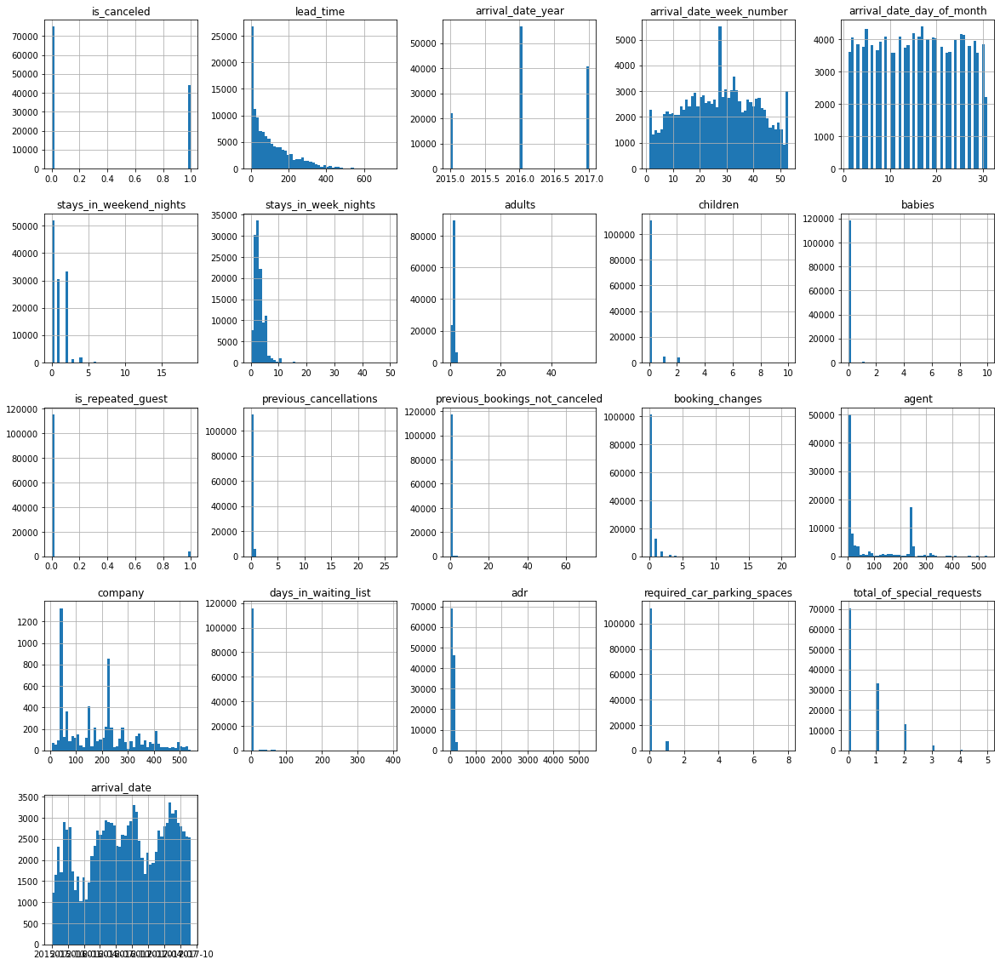

In [183]:
#See the distribution of the numerical features
df.hist(bins = 50, figsize = (20,20))

In [15]:
px.histogram(df, x='hotel', color = 'is_canceled')

City Hotel had more cancellations. Close to 45% of the total bookings

In [16]:
#how many cancellations vs normal
px.pie(df, names = 'is_canceled', title = 'Canceled vs Not Canceled')

Data is slightly imbalanced with 37% cancellations vs non-cancellations. To tackle class imbalance problem in modelling later, can use SMOTE (synthetic minority over sampling) method or just simply remove more percentage of normal ones into test set

In [80]:
df.groupby('arrival_date_month').count()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
arrival_date_month,,,,,,,,,,,,,,,,,,,,,
April,11089,11089,11089,11089,11089,11089,11089,11089,11089,11089,...,11089,9758,596,11089,11089,11089,11089,11089,11089,11089
August,13877,13877,13877,13877,13877,13877,13877,13877,13877,13873,...,13877,12682,288,13877,13877,13877,13877,13877,13877,13877
December,6780,6780,6780,6780,6780,6780,6780,6780,6780,6780,...,6780,5631,370,6780,6780,6780,6780,6780,6780,6780
February,8068,8068,8068,8068,8068,8068,8068,8068,8068,8068,...,8068,6461,741,8068,8068,8068,8068,8068,8068,8068
January,5929,5929,5929,5929,5929,5929,5929,5929,5929,5929,...,5929,4563,539,5929,5929,5929,5929,5929,5929,5929
July,12661,12661,12661,12661,12661,12661,12661,12661,12661,12661,...,12661,11604,300,12661,12661,12661,12661,12661,12661,12661
June,10939,10939,10939,10939,10939,10939,10939,10939,10939,10939,...,10939,9806,431,10939,10939,10939,10939,10939,10939,10939
March,9794,9794,9794,9794,9794,9794,9794,9794,9794,9794,...,9794,8149,731,9794,9794,9794,9794,9794,9794,9794
May,11791,11791,11791,11791,11791,11791,11791,11791,11791,11791,...,11791,10089,812,11791,11791,11791,11791,11791,11791,11791


In [98]:
#busiest months vs cancellations
px.histogram(df, x='arrival_date_month', color = 'is_canceled')

May to August had most bookings and as well the most cancellations. The hotel must be aware of these

In [23]:
from IPython.core.display import display, HTML
display(HTML('<iframe width="900" height="600" src="https://datastudio.google.com/embed/reporting/2f8bf5a3-b6f1-467a-a23a-21b0ae65adc1/page/FMAwC" frameborder="0" style="border:0" allowfullscreen></iframe>'))


A visual from Google Data Studio for an interactive Map of customers from around the world

In [174]:
#Visitors from top 20 countries
not_cancelled = df[df['is_canceled'] != 1][['country']].value_counts().reset_index()
#Most cancelled country visitors
cancelled = df[df['is_canceled'] == 1][['country']].value_counts().reset_index()
count_check = pd.merge(not_cancelled, cancelled, how='left', on='country')
count_check.rename({'0_x':'No_not_cancelled', '0_y': 'No_cancelled'}, axis=1, inplace=True)
count_check['total'] = count_check['No_cancelled']+count_check['No_not_cancelled']
count_check['percentage_cancelled'] = count_check['No_cancelled']/(count_check['total'])
count_check = count_check.sort_values(by='total', ascending=False)
count_check.head(15)

,country,No_not_cancelled,No_cancelled,total,percentage_cancelled
0,PRT,21071,27519.0,48590.0,0.566351
1,GBR,9676,2453.0,12129.0,0.202243
2,FRA,8481,1934.0,10415.0,0.185694
3,ESP,6391,2177.0,8568.0,0.254085
4,DEU,6069,1218.0,7287.0,0.167147
6,ITA,2433,1333.0,3766.0,0.353956
5,IRL,2543,832.0,3375.0,0.246519
7,BEL,1868,474.0,2342.0,0.202391
10,BRA,1394,830.0,2224.0,0.373201
8,NLD,1717,387.0,2104.0,0.183935


<AxesSubplot:xlabel='country', ylabel='percentage_cancelled'>

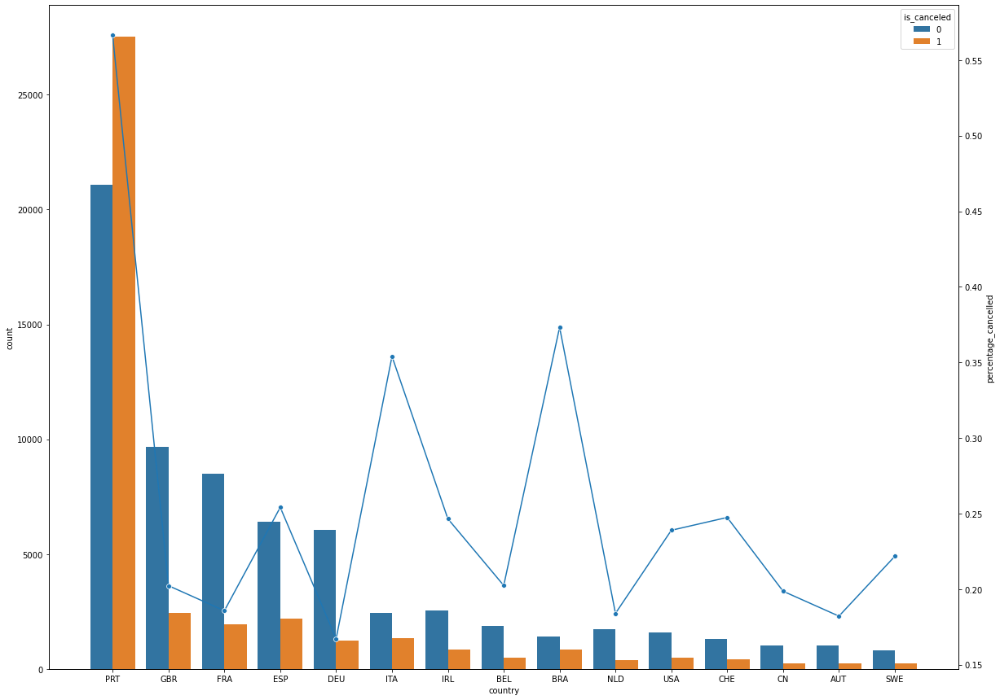

In [182]:
temp_df = df[df['country'].isin(count_check['country'].head(15))]
#px.histogram(temp_df, x='country', color='is_canceled', barmode='group')
fig, ax1 = plt.subplots(figsize=(20,15))
sns.countplot(x=temp_df['country'], hue=temp_df['is_canceled'], order=temp_df['country'].value_counts().index)
ax2 = ax1.twinx()
sns.lineplot(x = count_check.head(15)['country'], y = count_check.head(15)['percentage_cancelled'], marker='o', ax=ax2)

Most customers came from Portugal, with also the highest percentage of cancellations, 56%! Italy, and Brazil customers also had a very high cancellation rates

In [63]:
#market segment vs cancellations
px.histogram(df,x='market_segment', color = 'is_canceled', barmode='group')

Online bookings had the highest bookings, but with about 50% cancellations. Most cancellations came from Group market segments. Interesting to see that even complementary ones had about 97 cancellations, about 15% of total.

In [72]:
#customer type vs days in waiting list average
temp = df.groupby('customer_type').mean()['days_in_waiting_list']
px.bar(temp)

More waiting time for customers who booked the hotels for short-stays and especially for parties. Those on contract had the lowest waiting time

In [73]:
#customer type vs cancellation
px.histogram(df,x='customer_type', color = 'is_canceled', barmode='group')

Although transient-party customer type had a higher waiting time, the made lesser cancellations, probably also due to the need

In [77]:
#waiting list average vs cancellations
temp = df.groupby('is_canceled').mean()['days_in_waiting_list']
px.bar(temp, template='plotly_dark')

Those cancelled bookings had a higher waiting time in waiting list. Which, kind of makes sense

In [165]:
#checking the ADR distribution over the months. Note: months are not sorted
data = df[df['is_canceled'] == 0]

px.violin(data, x = 'arrival_date_month', y = 'adr', color = 'hotel', template = 'plotly_dark')

Both City Hotel and Resort Hotel have a higher median and mean values in July/August months for prices. Also they have higher outliers. Conforms with the price trend in the charts below. For these reason, outliers may not be removed in the modelling part, as they may heavily contribute to the cancellations

In [101]:
#reserved room type vs ADR => to check the cost of rooms
temp = data.groupby('reserved_room_type').median()['adr']
px.bar(temp, template='plotly_dark')

There are 5 types of expensive (> 150) room rates: Type C, F, G, H and L. With Types F, G, H being exclusive perhaps. Probably these are suite types. Will be interesting to see the customer segment persona with these, i.e families, business people, older couples etc

In [102]:
#Average Daily Rate(ADR) vs room types by hotel type
px.violin(data, x = 'reserved_room_type', y = 'adr', color = 'hotel', template = 'plotly_dark')

Although types C, F, G, H and L are the expensive ones, these room types have a rather normal distributions from the violin plot above. Rather the other types, especially types A and D have a positive skew and also some extreme outliers

In [130]:
#ADR by Hotel Types over the year
df_resort = data[data['hotel'] == 'Resort Hotel']
df_city = data[data['hotel'] == 'City Hotel']
resort_ = df_resort.groupby(['arrival_date_month'])['adr'].mean().reset_index()
city_ = df_city.groupby(['arrival_date_month'])['adr'].mean().reset_index()
hotel_ = pd.merge(resort_,city_, how='left', on='arrival_date_month')
hotel_ = hotel_.rename({'arrival_date_month': 'month', 'adr_x': 'city_cost', 'adr_y': 'resort_cost'}, axis = 1)
hotel_

,month,city_cost,resort_cost
0,April,75.867816,111.856824
1,August,181.205892,118.412083
2,December,68.322236,87.856764
3,February,54.147478,86.183025
4,January,48.708919,82.160634
5,July,150.122528,115.563810
6,June,107.921869,117.702075
7,March,57.012487,90.170722
8,May,76.657558,120.445842
9,November,48.681640,86.500456


In [141]:
hotel_['month2'] = pd.to_datetime(hotel_['month'],format='%B')
hotel_ = hotel_.sort_values(by='month2')

In [142]:
px.line(hotel_, x='month', y=['city_cost','resort_cost'])

Some observations for the monthly chart:
- Average Daily Rate or prices for City Hotel are higher during summer period. From May - Sept. Or in other words, they have skyrocketed during these periods. From these observations alone, we can deduce that the demand may be extremely high for this change
- Resort Hotel on average has a higher price compared to City Hotel as people normally prefer going to resorts, but as expected, prices rose slightly from March - November for Resort Hotels

In [143]:
#check the number of years of data
data['arrival_date_year'].unique()

array([2015, 2016, 2017])

In [151]:
#Create a new time feature from the dataset
df['arrival_date'] = df['arrival_date_day_of_month'].astype(str) + '/' + df['arrival_date_month'] + '/' \
+ df['arrival_date_year'].astype(str) 

In [153]:
df['arrival_date'] = pd.to_datetime(df['arrival_date'],format='%d/%B/%Y')
df['arrival_date']

0        2015-07-01
1        2015-07-01
2        2015-07-01
3        2015-07-01
4        2015-07-01
            ...    
119385   2017-08-30
119386   2017-08-31
119387   2017-08-31
119388   2017-08-31
119389   2017-08-29
Name: arrival_date, Length: 119390, dtype: datetime64[ns]

In [155]:
df = df.sort_values(by='arrival_date')

In [162]:
data = df[df['is_canceled'] == 0]
data = data.sort_values(by='arrival_date')
df_resort = data[data['hotel'] == 'Resort Hotel']
df_resort = df_resort.set_index('arrival_date')
df_city = data[data['hotel'] == 'City Hotel']
df_city = df_city.set_index('arrival_date')
resort_ = df_resort.resample('M')['adr'].mean().reset_index()
city_ = df_city.resample('M')['adr'].mean().reset_index()
hotel_ = pd.merge(resort_,city_, how='left', on='arrival_date')
hotel_ = hotel_.rename({'arrival_date': 'month-year', 'adr_x': 'city_cost', 'adr_y': 'resort_cost'}, axis = 1)
hotel_

,month-year,city_cost,resort_cost
0,2015-07-31,125.220860,73.591481
1,2015-08-31,153.238102,81.740096
2,2015-09-30,88.323791,103.536143
3,2015-10-31,56.945086,92.148281
4,2015-11-30,45.922120,71.385300
5,2015-12-31,64.944579,77.402860
6,2016-01-31,45.356771,75.298445
7,2016-02-29,51.576810,82.081020
8,2016-03-31,55.807686,87.806419
9,2016-04-30,67.054112,99.399644


In [164]:
px.line(hotel_, x='month-year', y=['city_cost','resort_cost'])

The chart above shows a few observations:
- There is a repeating pattern in price especially for City Hotel, i.e seasonal pattern in time series data from 2015 - 2017. **Higher price clearly noticeable in May - Sept of each year, possibly due to summer season and people prefer to travel** during these periods
- There is an **increasing trend in price from 2015 - 2017** for both hotel types as expected in any time series data when it involves price. Possibly due to rising costs and inflation. It will be interesting to see the price change over time vs the recorded inflation rate for the country of origin of this dataset
- Clearly prices are high during the summer period for City Hotel, and slightly higher for Resort Hotel. But other than that, Resort Hotel seems to be higher throughout as we saw in the aggregated monthly data above

In [27]:
df[(df['adults'] > 0 )& ((df['children'] > 0) | (df['babies'] > 0))][['children', 'babies', 'adults']]

,children,babies,adults
13,1.0,0,2
45,2.0,0,2
55,2.0,0,2
65,2.0,0,2
87,1.0,0,2
...,...,...,...
119270,1.0,0,2
119287,1.0,0,2
119293,2.0,0,2
119318,1.0,0,2


In [28]:
df[(df['adults'] == 0 )& ((df['children'] > 0) | (df['babies'] > 0))][['children', 'babies', 'adults']]

,children,babies,adults
40984,3.0,0,0
41048,2.0,0,0
41446,2.0,0,0
41952,2.0,0,0
45158,2.0,0,0
...,...,...,...
117204,2.0,0,0
117274,2.0,0,0
117303,2.0,0,0
117453,2.0,0,0


In [33]:
df[(df['adults'] == 0 )& ((df['children'] > 0) & (df['babies'] > 0))][['children', 'babies', 'adults']]

,children,babies,adults
46150,2.0,1,0
81375,2.0,1,0
90790,2.0,1,0


In [35]:
df[(df['adults'] == 0 )& ((df['children'] > 0) & (df['babies'] == 0))][['children', 'babies', 'adults']]

,children,babies,adults
40984,3.0,0,0
41048,2.0,0,0
41446,2.0,0,0
41952,2.0,0,0
45158,2.0,0,0
...,...,...,...
117204,2.0,0,0
117274,2.0,0,0
117303,2.0,0,0
117453,2.0,0,0


In [39]:
df[(df['adults'] == 0 )& ((df['children'] == 0) & (df['babies'] == 0))][['children', 'babies', 'adults']]

,children,babies,adults
2224,0.0,0,0
2409,0.0,0,0
3181,0.0,0,0
3684,0.0,0,0
3708,0.0,0,0
...,...,...,...
115029,0.0,0,0
115091,0.0,0,0
116251,0.0,0,0
116534,0.0,0,0


From quick analysis above on adults, children and babies. We will be making a few assumptions moving forward:
1. It is very unlikely that children and babies travel alone without adults. Hence the 223 rows of babies OR children without adults seem to be an error in recording, and may not provide any useful information, hence **will be removed in data preprocessing**
2. 180 rows that shows 0 adults, 0 babies and 0 children also seem to be an error so will also be removed in preprocessing
3. Can generate new feature, `Family Type` with
    - **Family**: adults > 0 AND (children OR babies) > 0
    - **Couple**: 2 adults AND 0 (children OR babies)
    - **Single**: 1 adult AND 0 (children OR babies)
    - **Adult Group**: More than 2 adults without children or babies

## Data Science Use Cases
This section highlights some use cases for the Hotel Owner and Guests

### Hotel Owner
Some of the EDA in the section above directly contributes to the insights for the hotel owner. To recap:
- most bookings will happen in Summer period, i.e from May - Sep of every year
- expect most cancellations ~ 30-40% cancellations during the summer period also
- Need to be wary of prices, as price skyrocketed during these periods, may have caused a lot of cancellations too. Suggest to have a slight reduction in price to get the volume in, as this is an elastic commodity
- More waiting times may cause more cancellations
- Transient customers tend to cancel a lot more
- Customers from Portugal had the highest bookings, but also about 56% cancellation rates. Need to provide some incentives to Portuguese customers in this sense. Also for Italy and Brazillian customers.
- Having noted that Portuguese and Brazillians speak almost the same language, can provide some level of native treatment for these customer types
- Most bookings came from online, time to increase online presence a lot more
- Group market segments also cancelled the most. Which means that the owner will need to introduce some new schemes to pay extra for cancellations for these customer groups

<u>Data Science Use Cases for Owners</u>
1. Prediction of Customer Lifetime Value by using some important features and use in unsupervised learning
2. Customer segmentation using unsupervised learning to learn the customer personas
3. Marketing recommendation engines based on customer segments, market segments and customer lifetime value => to increase sales over time
4. Booking cancellation model to see the probability of a customer churning
5. Best price predictor based on inflation and other economic factors
6. Prediction of the number of booking nights for any new bookings

### Hotel Guests
For hotel guests, their needs and use cases differ from Hotel Owners

<u>Data Science Use Cases for Guests</u>
1. Prediction on lowest price for hotel booking based on number of nights stay and demographics
2. Recommendation on different room types with similar or cheaper price based on past stay history
3. Recommendation on similar meals/room types/room price based on people of similar profile, even from different countries
4. Insight of what is the best time to travel based on needs (i.e business, leisure, party) with best room rates and seasonality recommendation
5. Incorporate weather patterns from weather data to recommend that there may be rain/snow/shine during the time of hotel booking
